In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random

In [2]:
DatabaseDF = pd.read_csv("../CleanedDataset.csv")

DatabaseDF.head()

,Unnamed: 0,Operator,Well Name,Formation,Lateral Length,Stages,Township,Range,Section,"Total Prop, lbs",...,Fluid Type from DI,SPACING_CAPPED,12 month Cum Prod,Completion Type,Sleeves,P&P,Frac Ports,Repeater Ports,CT,Year Drilled
0,0,Operator 1,Well 1,MBH,5114.0,30.0,141,99,10,0.0,...,NaN,660.0,33.55,NaN,NaN,NaN,NaN,NaN,NaN,2006.0
1,1,Operator 2,Well 2,MBH,5181.0,NaN,142,99,16,418000.0,...,NaN,660.0,27.62,NaN,NaN,NaN,NaN,NaN,NaN,2005.0
2,2,Operator 2,Well 3,MBH,4780.0,15.0,142,99,24,568407.0,...,NaN,660.0,11.19,OH,NaN,NaN,NaN,NaN,NaN,2006.0
3,3,Operator 1,Well 4,MBH,10654.0,1.0,142,99,1,845000.0,...,NaN,660.0,27.85,NaN,NaN,NaN,NaN,NaN,NaN,2007.0
4,4,Operator 2,Well 5,MBH,5209.0,1.0,142,99,35,297366.0,...,NaN,660.0,50.88,OH,NaN,NaN,NaN,NaN,NaN,2006.0


## Definition

Voroni Diagrams are useful for determining information about an area given only a finite ammount of data points in that area, I will firstly create a function that does what I want and then will use it to explore interesting results from our data

## Voronoi Function

In [3]:
from scipy.spatial import Voronoi, voronoi_plot_2d
import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.colors as mcolors

In [4]:
def voronoiPlot(dataframe = DatabaseDF, var = '12 month Cum Prod', colorDictionary = None):

    # generate data/speed values
    points = dataframe[['Longitude','Latitude']]
    values = dataframe[var]

    # generate Voronoi tessellation
    vor = Voronoi(points)

    if (colorDictionary is None):
        # find min/max values for normalization
        minima = min(values)
        maxima = max(values)

        # normalize chosen colormap
        norm = mpl.colors.Normalize(vmin=minima, vmax=maxima, clip=True)
        mapper = cm.ScalarMappable(norm=norm, cmap=cm.Blues_r)

    # plot Voronoi diagram, and fill finite regions with color mapped from speed value
    fig = voronoi_plot_2d(vor, show_points=False, show_vertices=False, s=1, line_width = 1, line_alpha = .2)

    fig.set_size_inches((15,10))

    for r in range(len(vor.point_region)):
        region = vor.regions[vor.point_region[r]]
        if not -1 in region:
            polygon = [vor.vertices[i] for i in region]
            if (colorDictionary is None):
                plt.fill(*zip(*polygon), color=mapper.to_rgba(values[r]))
            else:
                plt.fill(*zip(*polygon), color=colorDictionary[values[r]])

    plt.show()

In [5]:
def createColorDictionary(ObjectList):
    colorDict = {}

    colorL = list(mcolors.TABLEAU_COLORS.keys())
    colorL.remove('tab:brown')
    colorL.remove('tab:gray')\

    colorList = random.choices(colorL, k = len(ObjectList))

    for i in range(len(ObjectList)):
        colorDict[ObjectList[i]] = colorList[i]

    return colorDict

## Plotting Voronoi Graphs

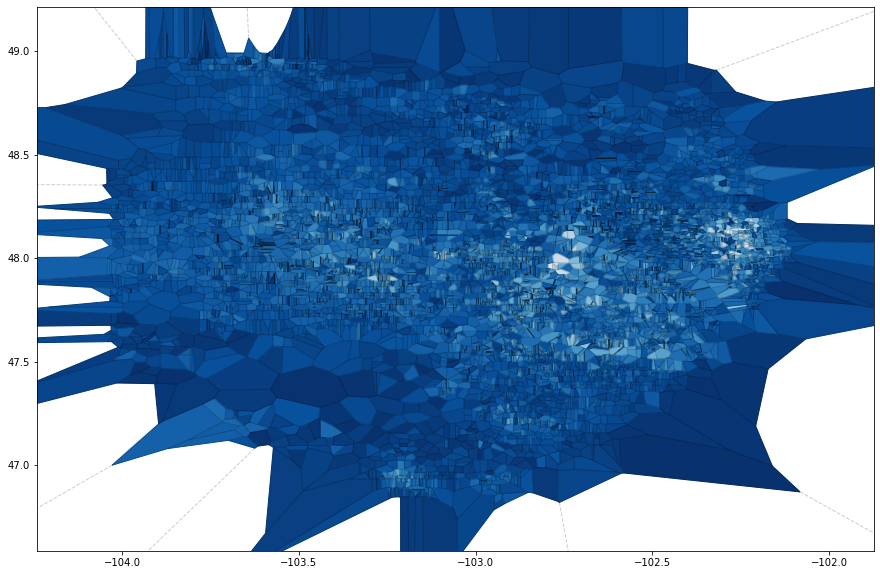

In [6]:
voronoiPlot()

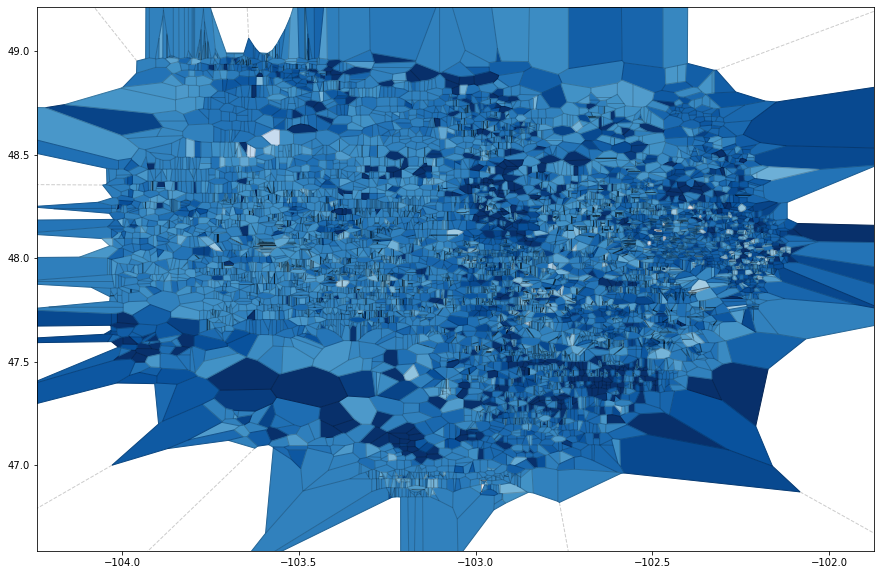

In [7]:
voronoiPlot(var = 'Stages')

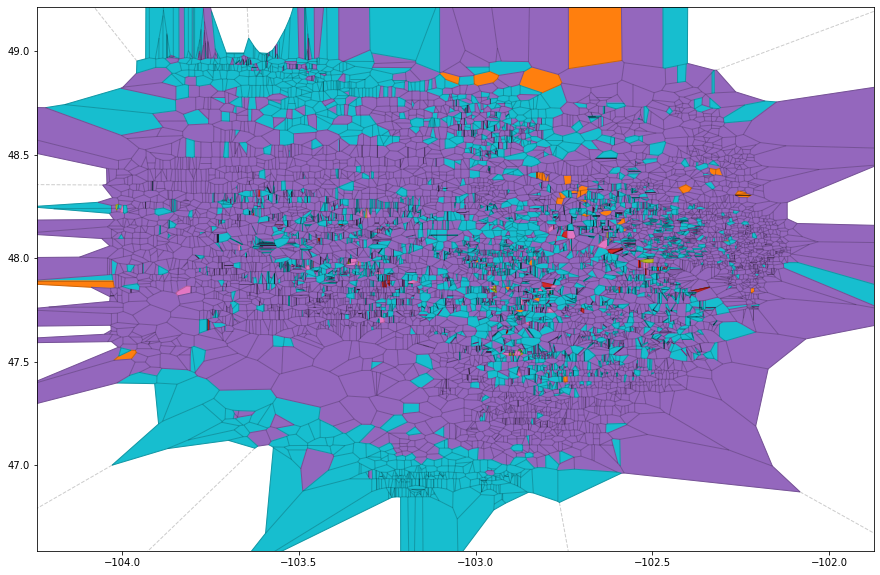

In [8]:
formationColorDict = createColorDictionary(DatabaseDF['Formation'].unique())
voronoiPlot(var = 'Formation', colorDictionary = formationColorDict)